In [2]:
!pip install -q ultralytics roboflow opencv-python-headless matplotlib

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 27.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 89.9/89.9 kB 7.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 49.9/49.9 MB 17.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 66.8/66.8 kB 5.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.4/1.4 MB 74.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.2/4.2 MB 101.3 MB/s eta 0:00:00


In [1]:
from roboflow import Roboflow
from getpass import getpass
import os
import random
from IPython.display import display, Image
import torch
import cv2
from ultralytics import YOLO
import pandas as pd
from google.colab import drive
import torch
import matplotlib.pyplot as plt

### Connect to Roboflow with API

In [2]:
api_key = getpass("Paste your Roboflow API key (it will NOT be shown): ")
os.environ["ROBOFLOW_API_KEY"] = api_key

Paste your Roboflow API key (it will NOT be shown): ··········


In [3]:
rf = Roboflow(api_key=os.environ["ROBOFLOW_API_KEY"])

### DATASET"car-damage-detection-dy5hu"

In [4]:
project = rf.workspace("celebalworkspace").project("car-damage-detection-dy5hu")

loading Roboflow workspace...
loading Roboflow project...


In [5]:
dataset = project.version(1).download("yolov8")

### The number of training pictures and how to display them.

In [6]:
train_image_dir = os.path.join(dataset.location, "train", "images")
image_files = [f for f in os.listdir(train_image_dir) if f.endswith(('.jpg', '.jpeg', '.png'))]
print(f"Number of training images: {len(image_files)}")

Number of training images: 260


Displaying 7 random images from the training dataset:


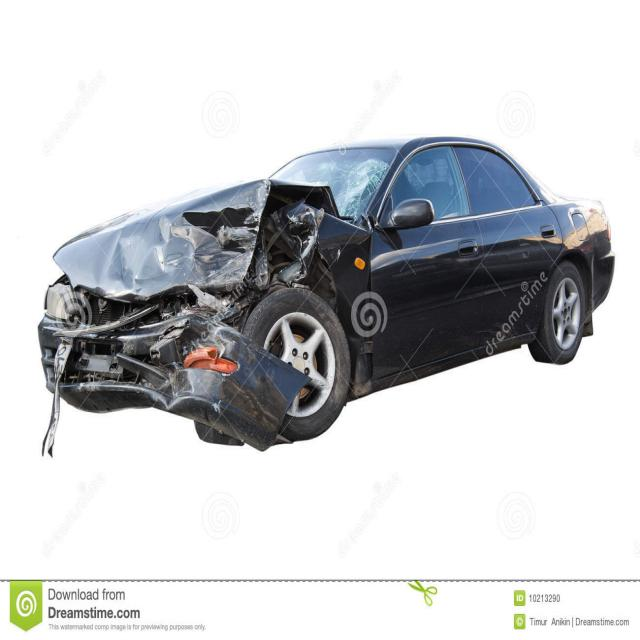

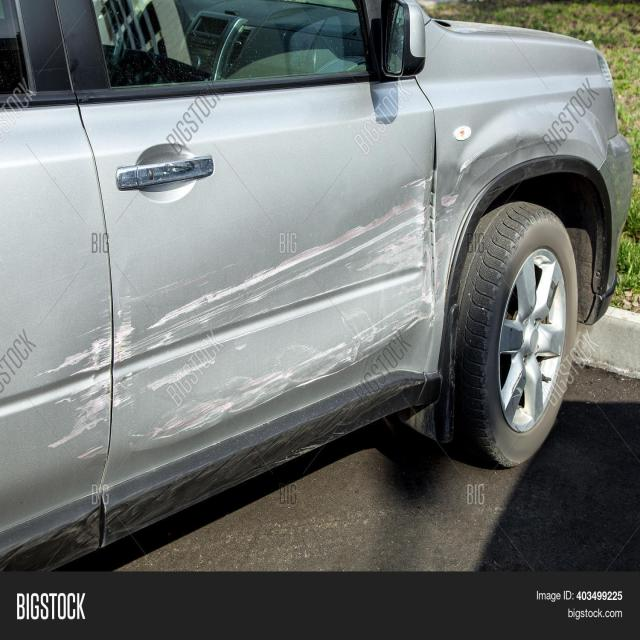

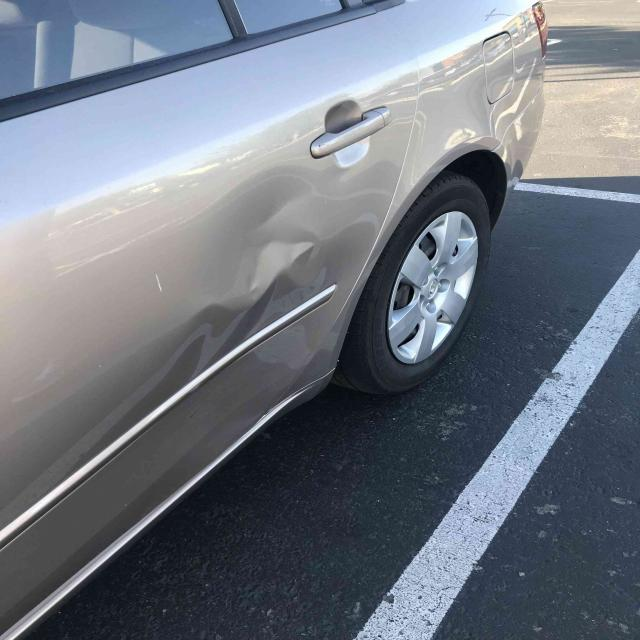

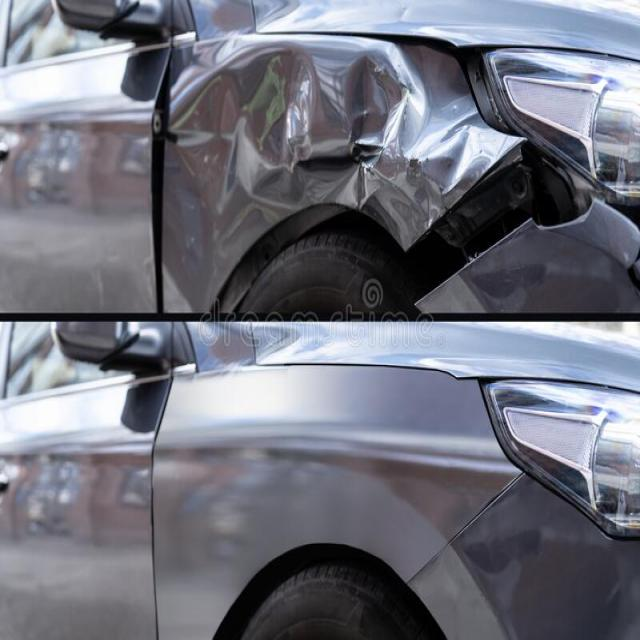

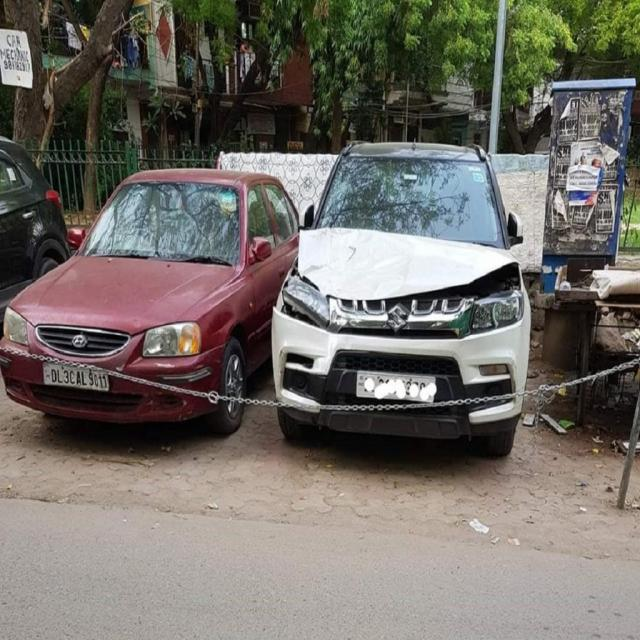

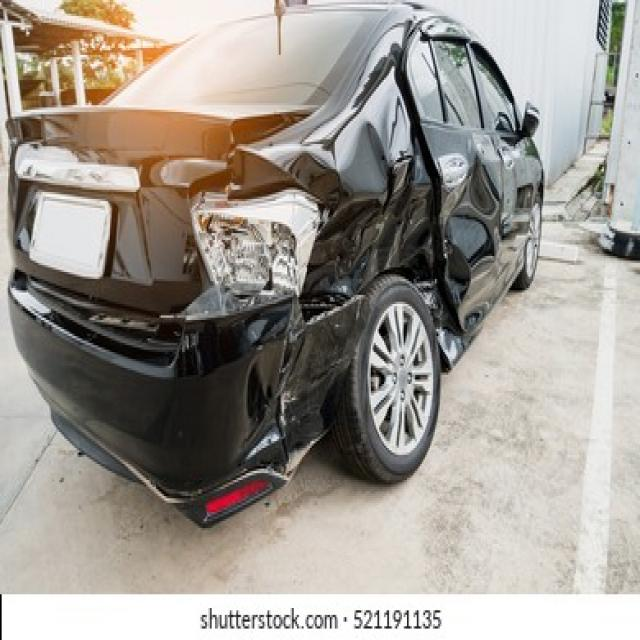

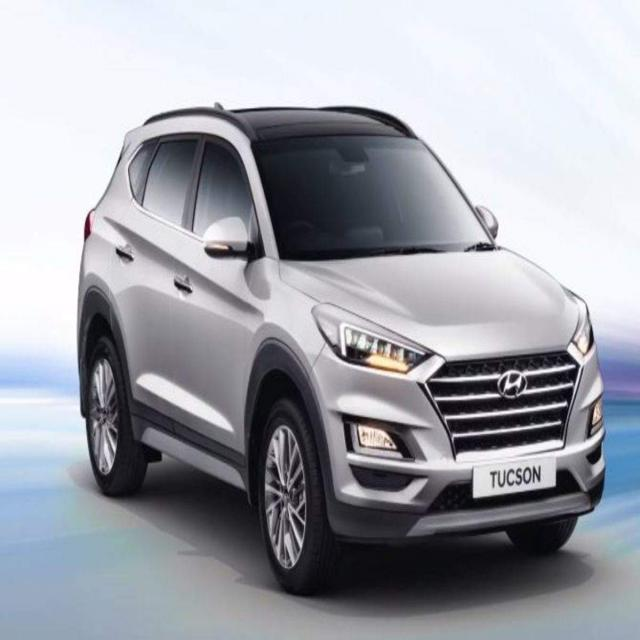

In [7]:
train_image_dir = os.path.join(dataset.location, "train", "images")
image_files = [f for f in os.listdir(train_image_dir) if f.endswith(('.jpg', '.jpeg', '.png'))]

if not image_files:
    print("No image files found in the training directory.")
else:
    # Display a few random images
    num_images_to_show = min(7, len(image_files))
    print(f"Displaying {num_images_to_show} random images from the training dataset:")
    for _ in range(num_images_to_show):
        random_image_file = random.choice(image_files)
        image_path = os.path.join(train_image_dir, random_image_file)
        display(Image(filename=image_path))

### Run Yolo model and train pretrain model

In [42]:
model = YOLO("yolov8n.pt")

In [43]:
model.train(data=dataset.location + "/data.yaml", epochs=50, imgsz=640, batch=16, warmup_epochs=3,hsv_h=0.015, scale=0.7, translate=0.1, hsv_s=0.7,hsv_v=0.4,
            name="car_damage_yolov8", patience=50, device=0,optimizer="SGD", warmup_momentum=0.8, warmup_bias_lr=0.1,
            mosaic=0.5,multi_scale=True)

Ultralytics 8.3.218 🚀 Python-3.12.12 torch-2.8.0+cu126 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, compile=False, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=/content/Car-damage-detection-1/data.yaml, degrees=0.0, deterministic=True, device=0, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=50, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolov8n.pt, momentum=0.937, mosaic=0.5, multi_scale=True, name=car_damage_yolov87, nbs=64, nms=False, opset=None, optimize=False, optimizer=SGD, overlap_mask=True, patience=50, perspective=0.0

ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([1, 2, 3, 4, 5, 6])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x7f2e4801ea20>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
     

### Table box loss and cls loss

In [44]:
df = pd.read_csv("runs/detect/car_damage_yolov87/results.csv")
df

,epoch,time,train/box_loss,train/cls_loss,train/dfl_loss,metrics/precision(B),metrics/recall(B),metrics/mAP50(B),metrics/mAP50-95(B),val/box_loss,val/cls_loss,val/dfl_loss,lr/pg0,lr/pg1,lr/pg2
0,1,11.0467,1.58636,4.50243,1.78045,0.00228,0.49277,0.06146,0.04536,1.38623,3.51842,1.83032,0.085600,0.001600,0.001600
1,2,17.0775,1.57844,4.59406,1.80531,0.00267,0.58392,0.11479,0.09523,1.39976,3.55704,1.76203,0.070235,0.003235,0.003235
2,3,23.0392,1.39838,4.08887,1.62181,1.00000,0.08031,0.18101,0.12612,1.57093,3.32401,1.86122,0.054802,0.004802,0.004802
3,4,29.2979,1.54509,4.20418,1.81471,0.00331,0.65173,0.11328,0.05558,1.80238,3.43495,2.04555,0.039302,0.006302,0.006302
4,5,34.1735,1.54834,3.90948,1.74456,0.96130,0.08333,0.12377,0.07822,2.16718,3.20317,2.42618,0.023735,0.007735,0.007735
5,6,40.4807,1.65399,4.09041,1.83353,0.75931,0.10714,0.09791,0.03334,2.17387,3.33636,2.55348,0.009010,0.009010,0.009010
6,7,45.9324,1.58455,3.73316,1.77982,0.66667,0.09009,0.15485,0.08851,2.11149,3.07294,2.23145,0.008812,0.008812,0.008812
7,8,51.5879,1.71160,3.86519,1.83190,0.88992,0.13095,0.10368,0.03488,2.32602,3.36929,2.63932,0.008614,0.008614,0.008614
8,9,57.0128,1.77693,3.53784,1.78126,0.91357,0.09524,0.09448,0.05344,2.21987,3.23909,2.47507,0.008416,0.008416,0.008416
9,10,61.8795,1.73975,3.51306,1.81917,0.72559,0.09524,0.09606,0.02733,2.33447,3.61267,2.80131,0.008218,0.008218,0.008218


### Plot Cls loss and Box loss

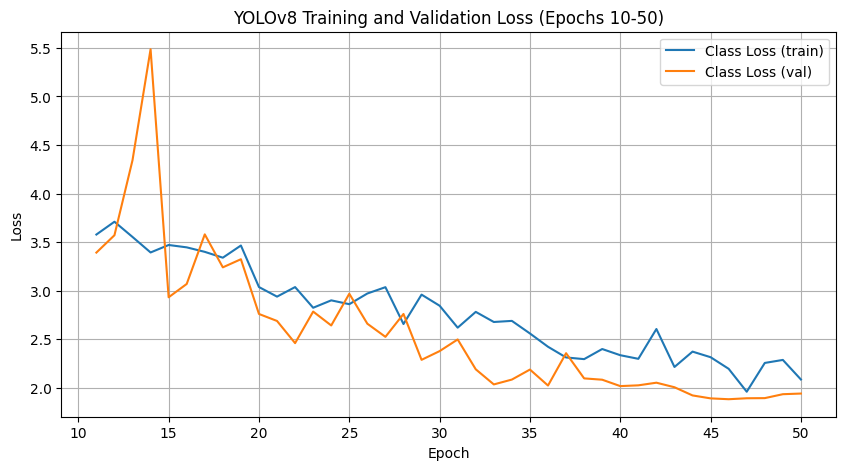

In [45]:
plt.figure(figsize=(10,5))
plt.plot(df["epoch"][10:50], df["train/cls_loss"][10:50], label="Class Loss (train)")
plt.plot(df["epoch"][10:50], df["val/cls_loss"][10:50], label="Class Loss (val)")
plt.xlabel("Epoch")
plt.ylabel("Loss")
plt.title("YOLOv8 Training and Validation Loss (Epochs 10-50)")
plt.legend()
plt.grid()
plt.show()

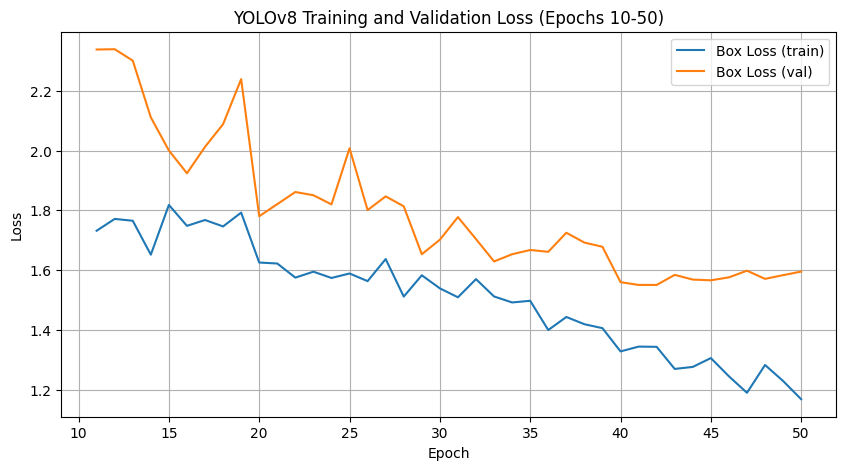

In [46]:
plt.figure(figsize=(10,5))
plt.plot(df["epoch"][10:50], df["train/box_loss"][10:50], label="Box Loss (train)")

plt.plot(df["epoch"][10:50], df["val/box_loss"][10:50], label="Box Loss (val)")

plt.xlabel("Epoch")
plt.ylabel("Loss")
plt.title("YOLOv8 Training and Validation Loss (Epochs 10-50)")
plt.legend()
plt.grid()
plt.show()

### Test

In [67]:
results = model.predict(source=dataset.location + "/test/images", conf=0.15,  device=0)


image 1/38 /content/Car-damage-detection-1/test/images/Car-Broken-Headlamp_12_jpeg.rf.de6c7a2e043489fa394156e31600dda4.jpg: 640x640 1 Broken-hood, 2 Broken-lights, 15.9ms
image 2/38 /content/Car-damage-detection-1/test/images/Car-Broken-Headlamp_13_jpeg.rf.23315d8135bcb6291aa9c5c40fa1b36b.jpg: 640x640 3 Broken-lights, 13.2ms
image 3/38 /content/Car-damage-detection-1/test/images/Car-Broken-Headlamp_22_jpeg.rf.ba7d2418a1da48f7e16a95c45823362d.jpg: 640x640 2 Broken-lights, 9.0ms
image 4/38 /content/Car-damage-detection-1/test/images/Car-Broken-Headlamp_42_png.rf.795ec1c52946bd286d6f6d8dc1f0ceea.jpg: 640x640 (no detections), 24.8ms
image 5/38 /content/Car-damage-detection-1/test/images/Car-Glass-Shatter_34_jpeg.rf.dd8ef701df78ff8cc6d4f1b200606df1.jpg: 640x640 (no detections), 28.6ms
image 6/38 /content/Car-damage-detection-1/test/images/Car-broken-backside-glass_11_jpeg.rf.309b9e7b3de84d48ca5ec9cbf7bb4454.jpg: 640x640 (no detections), 23.8ms
image 7/38 /content/Car-damage-detection-1/tes

In [68]:
res = results[0]
res

ultralytics.engine.results.Results object with attributes:

boxes: ultralytics.engine.results.Boxes object
keypoints: None
masks: None
names: {0: '15', 1: 'Broken-Glass', 2: 'Broken-hood', 3: 'Broken-light', 4: 'Dent', 5: 'Scratch', 6: 'Undamaged'}
obb: None
orig_img: array([[[49, 47, 46],
        [48, 46, 45],
        [45, 43, 42],
        ...,
        [97, 92, 89],
        [97, 92, 89],
        [97, 92, 89]],

       [[44, 42, 41],
        [45, 43, 42],
        [45, 43, 42],
        ...,
        [91, 86, 83],
        [92, 87, 84],
        [92, 87, 84]],

       [[37, 35, 34],
        [41, 39, 38],
        [44, 42, 41],
        ...,
        [93, 88, 85],
        [93, 88, 85],
        [93, 88, 85]],

       ...,

       [[29, 29, 29],
        [28, 28, 28],
        [26, 26, 26],
        ...,
        [50, 50, 50],
        [40, 40, 40],
        [32, 32, 32]],

       [[28, 28, 28],
        [28, 28, 28],
        [27, 27, 27],
        ...,
        [33, 33, 33],
        [26, 26, 26],
       

### Depicting Detection car damage

In [69]:
img = cv2.imread(res.path)
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)


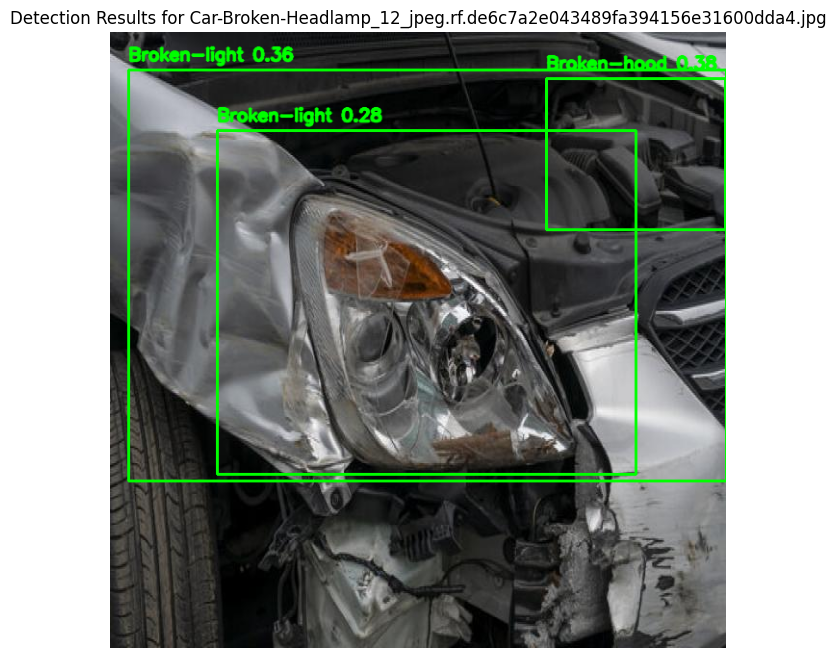

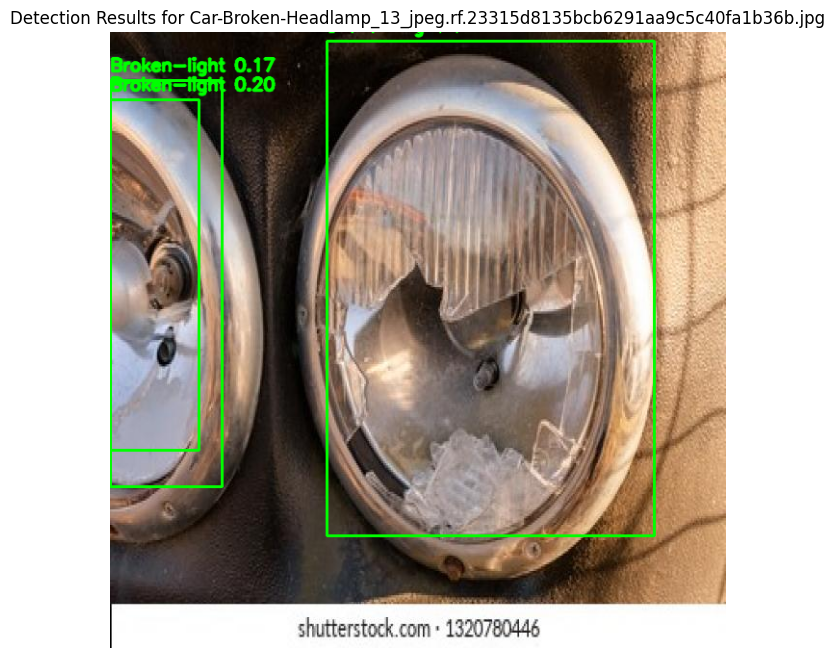

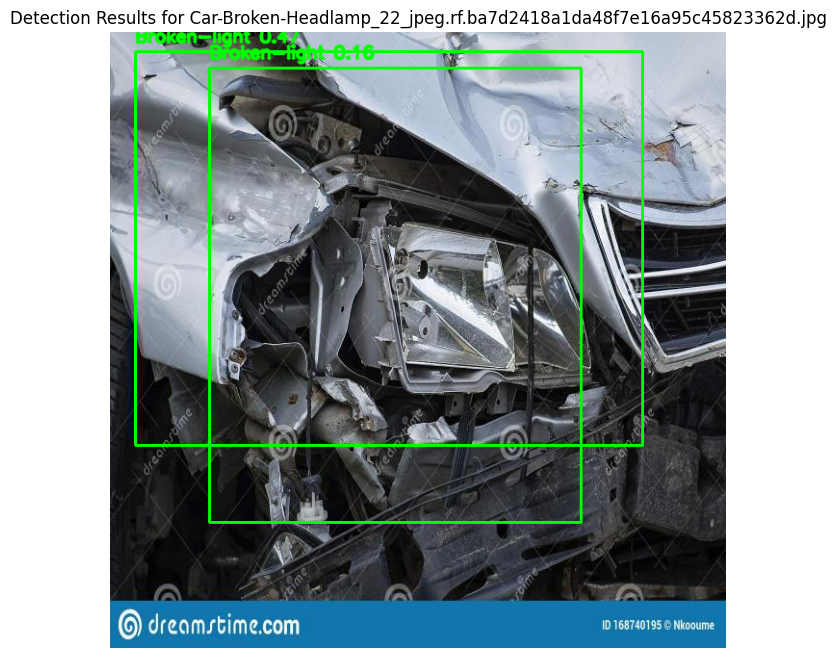

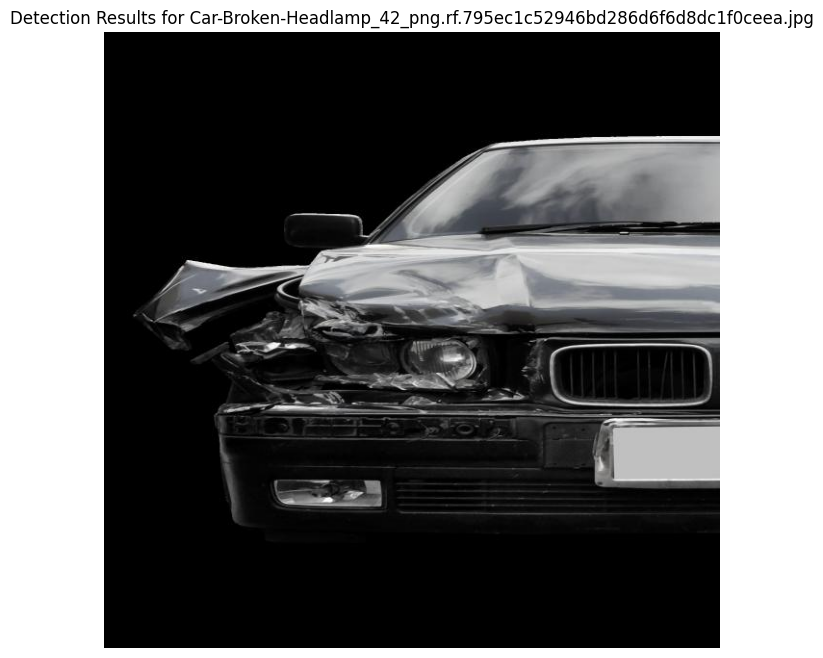

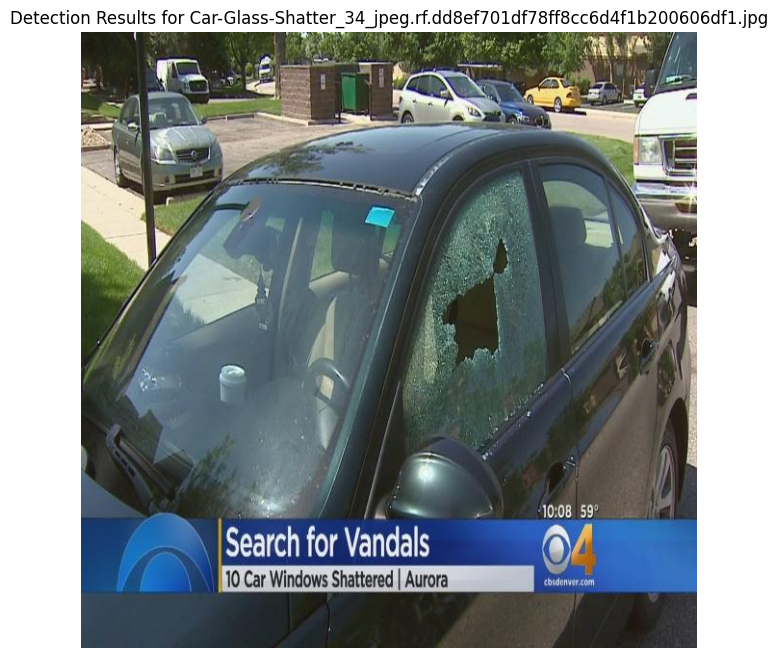

...

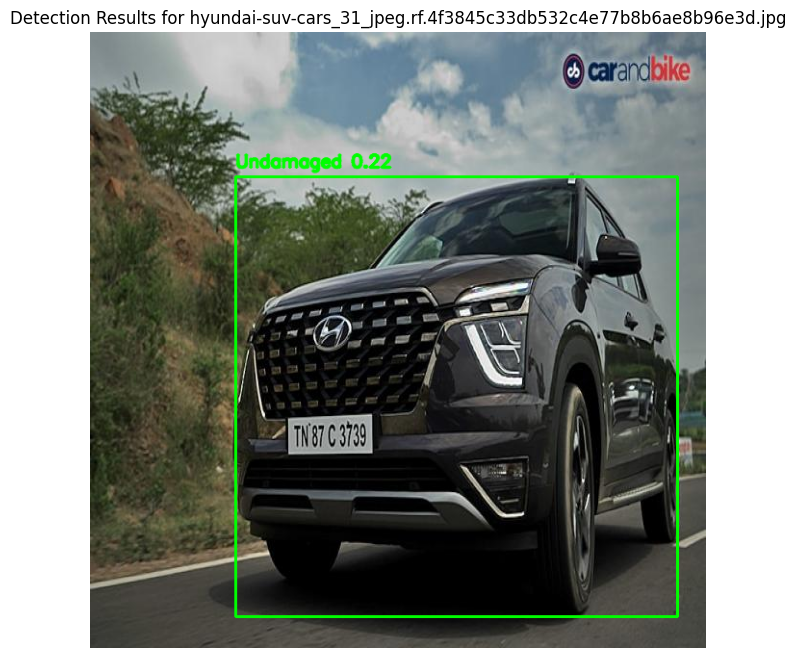

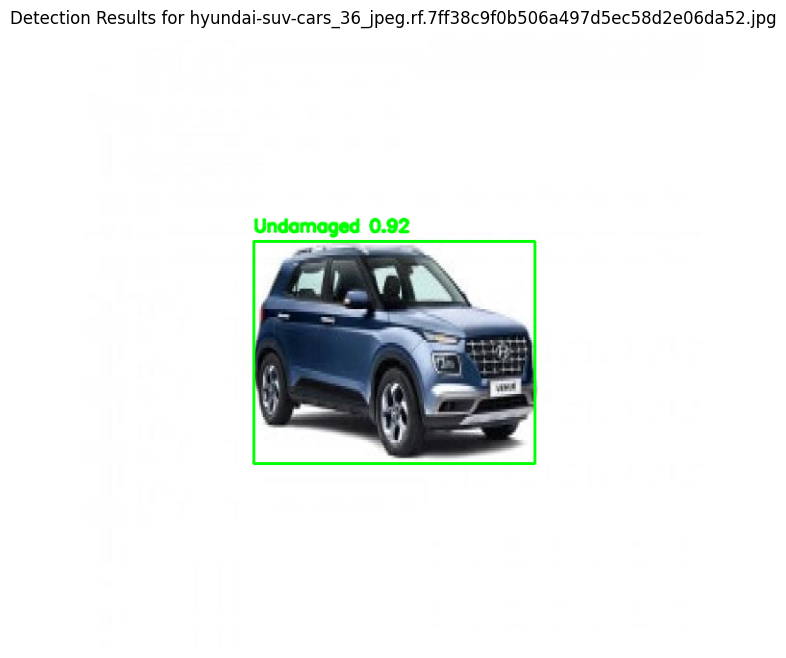

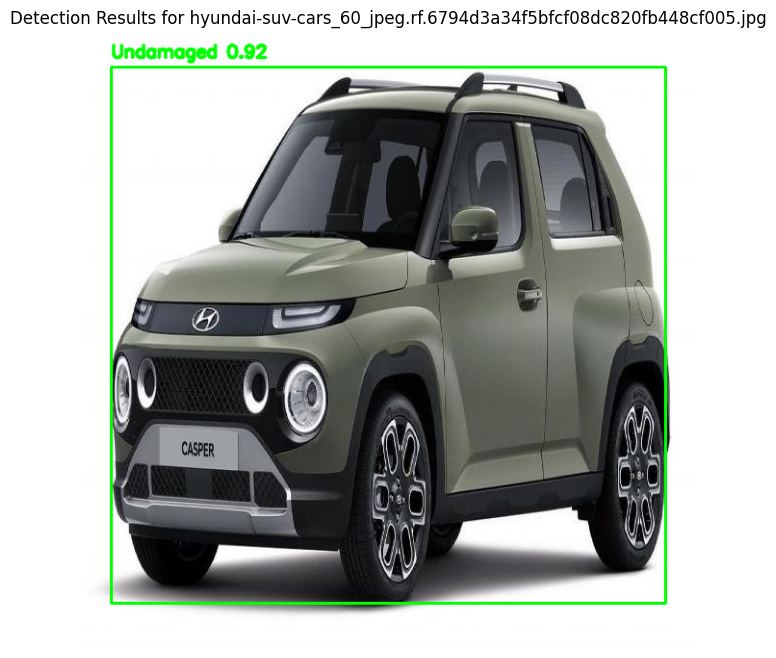

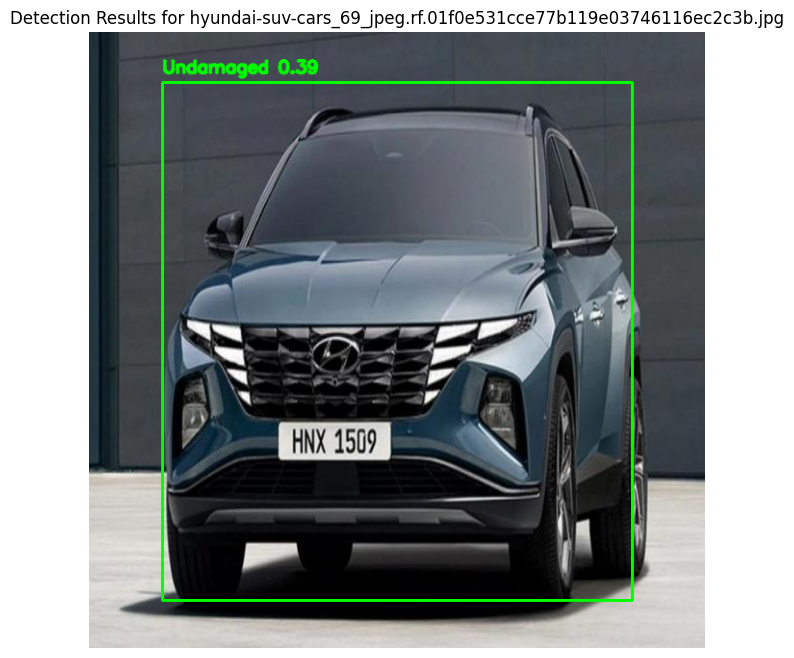

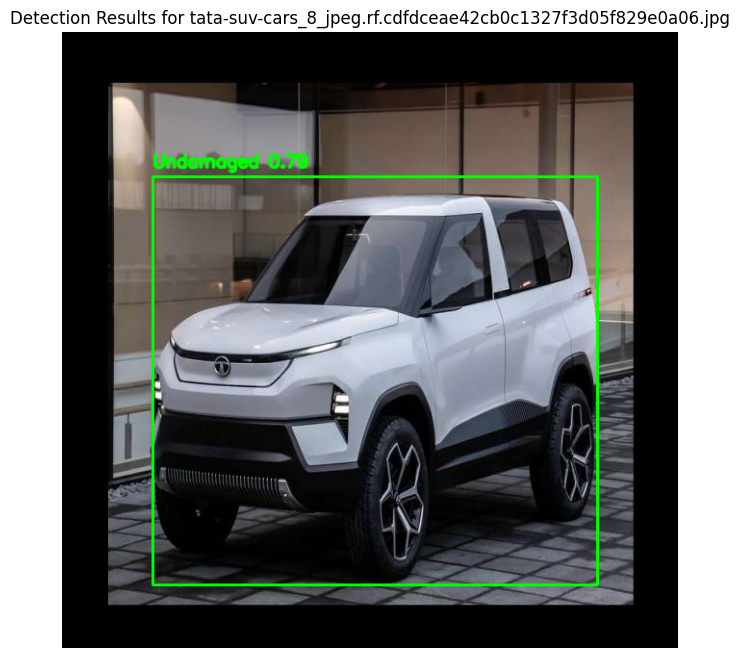

In [70]:
for res in results:
    img = cv2.imread(res.path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    for box in res.boxes:
        # مختصات
        x1, y1, x2, y2 = map(int, box.xyxy[0])
        # نام کلاس
        cls = res.names[int(box.cls[0])]
        # میزان اطمینان
        conf = float(box.conf[0])

        # رسم مستطیل سبز
        cv2.rectangle(img, (x1, y1), (x2, y2), (0, 255, 0), 2)
        # نوشتن برچسب بالای کادر
        label = f"{cls} {conf:.2f}"
        cv2.putText(img, label, (x1, y1 - 10), cv2.FONT_HERSHEY_SIMPLEX,
                    0.6, (0, 255, 0), 2, cv2.LINE_AA)

    # نمایش با matplotlib
    plt.figure(figsize=(10, 8))
    plt.imshow(img)
    plt.axis('off')
    plt.title(f"Detection Results for {res.path.split('/')[-1]}")
    plt.show()

Testing Model For an iranian car

In [71]:
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [72]:
results = model.predict(source="/content/drive/MyDrive/Colab Notebooks/fm3.jpg",conf=0.15,  device=0)


image 1/1 /content/drive/MyDrive/Colab Notebooks/fm3.jpg: 512x640 1 Broken-hood, 13.9ms
Speed: 4.2ms preprocess, 13.9ms inference, 2.0ms postprocess per image at shape (1, 3, 512, 640)


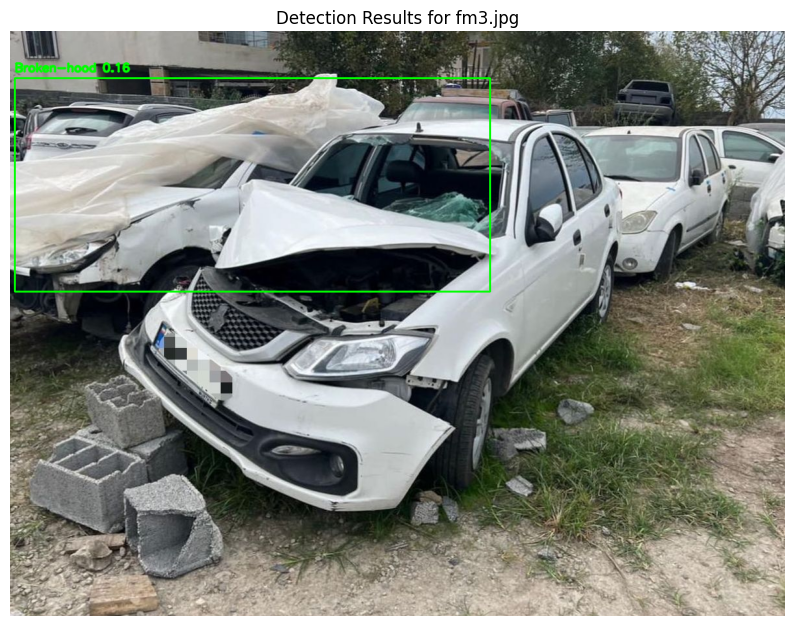

In [73]:
for res in results:
    img = cv2.imread(res.path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    for box in res.boxes:
        # مختصات
        x1, y1, x2, y2 = map(int, box.xyxy[0])
        # نام کلاس
        cls = res.names[int(box.cls[0])]
        # میزان اطمینان
        conf = float(box.conf[0])

        # رسم مستطیل سبز
        cv2.rectangle(img, (x1, y1), (x2, y2), (0, 255, 0), 2)
        # نوشتن برچسب بالای کادر
        label = f"{cls} {conf:.2f}"
        cv2.putText(img, label, (x1, y1 - 10), cv2.FONT_HERSHEY_SIMPLEX,
                    0.6, (0, 255, 0), 2, cv2.LINE_AA)

    # نمایش با matplotlib
    plt.figure(figsize=(10, 8))
    plt.imshow(img)
    plt.axis('off')
    plt.title(f"Detection Results for {res.path.split('/')[-1]}")
    plt.show()